In [1]:
using Distributions
using StatsPlots
using StatsBase
using CSV
using DataFrames
using LinearAlgebra
using Random
using Turing

In [2]:
# helper function for getting credibility interval
CredI(d; p = 0.95) = [quantile(d, (1-p)/2), quantile(d, (1+p)/2)]

CredI (generic function with 1 method)

In [3]:
d = DataFrame(CSV.File("data/Howell1.csv"));
d2 = d[d.age .>= 18,:];  # select only those data from adults

In [4]:
d2

Row,height,weight,age,male
,Float64,Float64,Float64,Int64
1,151.765,47.8256,63.0,1
2,139.7,36.4858,63.0,0
3,136.525,31.8648,65.0,0
4,156.845,53.0419,41.0,1
5,145.415,41.2769,51.0,0
6,163.83,62.9926,35.0,1
7,149.225,38.2435,32.0,0
8,168.91,55.48,27.0,1
9,147.955,34.8699,19.0,0


In [5]:
describe(d2)

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Real,Float64,Real,Int64,DataType
1,height,154.597,136.525,154.305,179.07,0,Float64
2,weight,44.9905,31.0711,44.7922,62.9926,0,Float64
3,age,41.1385,18.0,39.0,88.0,0,Float64
4,male,0.46875,0,0.0,1,0,Int64


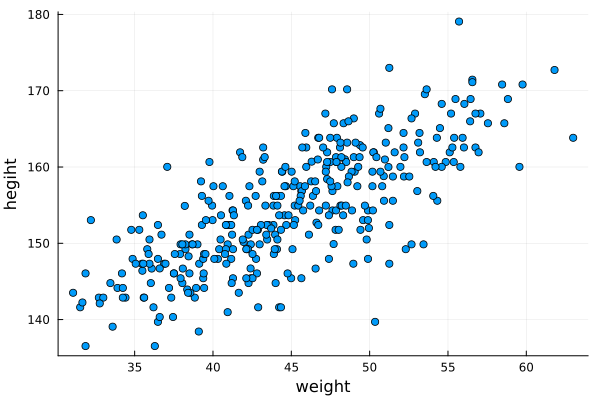

In [6]:
scatter(d2.weight, d2.height, xlabel="weight", ylabel="hegiht", legend=false)

In [7]:
x̄ = mean(d2.weight)

44.99048551988637

In [8]:
h̄ = mean(d2.height)

154.59709261363633

In [9]:
xlims = extrema(d2.weight)  # getting min and max in one pass for later plotting purposes
ylims = extrema(d2.height)

(136.525, 179.07)

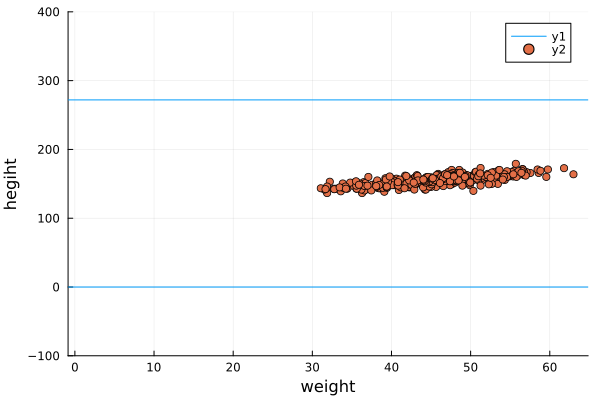

In [10]:
p = hline([0, 272]; ylims=(-100, 400), xlabel="weight", ylabel="hegiht")
scatter!(d2.weight, d2.height)

In [11]:
# see what the normal distributions for α and β give
Random.seed!(2971)
N = 100
α = rand(Normal(178, 20), N);
β = rand(Normal(0, 10), N);

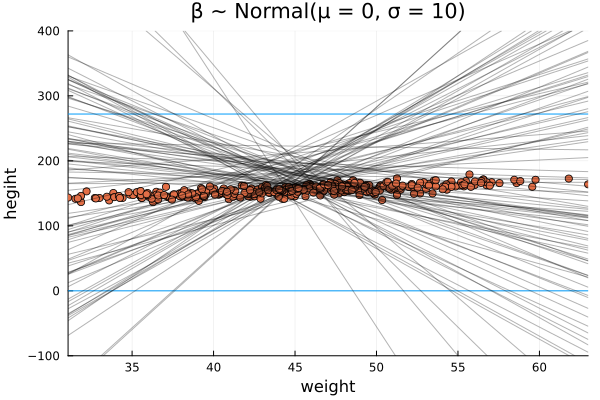

In [12]:
for (α_, β_) ∈ zip(α, β)
    plot!(x -> α_ + β_ * (x - x̄); xlims=xlims, c=:black, alpha=0.3, legend=false)
end
title!("β ~ Normal(μ = 0, σ = 10)")
display(p)

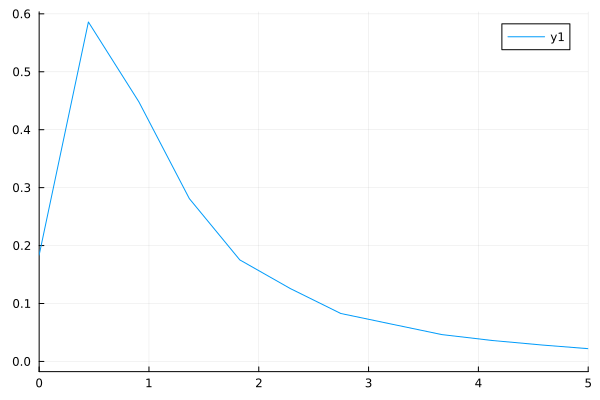

In [13]:
β = rand(LogNormal(0, 1), 10_000)
density(β, xlims=(0, 5), bandwidth=0.01)

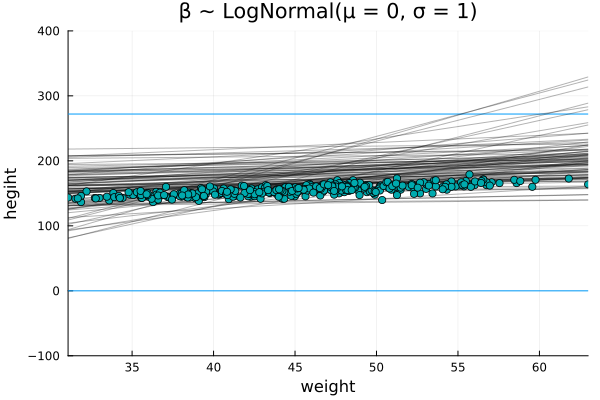

In [14]:
# see what the log-normal distribution for β gives

p = hline([0, 272]; ylims=(-100, 400), xlabel="weight", ylabel="hegiht")

title!("β ~ LogNormal(μ = 0, σ = 1)")

for (α_, β_) ∈ zip(α, β)
  plot!(x -> α_ + β_ * (x - x̄); xlims=xlims, c=:black, alpha=0.3, legend=false)
end

scatter!(d2.weight, d2.height)

display(p)


In [15]:
# define our Bayesian statistics model for linear regression
@model function height_regr_model(x, h)
    
    α ~ Normal(178, 20)
    β ~ LogNormal(0, 1)
    σ ~ Uniform(0, 50)
  
    for i in 1:length(x)
        h[i] ~ Normal(α + β * (x[i] - x̄), σ)
    end

    #μ = α .+ β * (x .- x̄)
    #h ~ MvNormal(μ, σ)

end

height_regr_model (generic function with 2 methods)

In [16]:
m = sample(height_regr_model(d2.weight, d2.height), NUTS(), 1000);

Sampling   0%|                                          |  ETA: N/A
┌ Info: Found initial step size
│   ϵ = 0.05
└ @ Turing.Inference /Users/lime/.julia/packages/Turing/vX5F9/src/mcmc/hmc.jl:213
Sampling   0%|▎                                         |  ETA: 0:15:16
Sampling   1%|▍                                         |  ETA: 0:07:37
Sampling   1%|▋                                         |  ETA: 0:05:04
Sampling   2%|▊                                         |  ETA: 0:03:47
Sampling   2%|█                                         |  ETA: 0:03:01
Sampling   3%|█▏                                        |  ETA: 0:02:30
Sampling   3%|█▍                                        |  ETA: 0:02:08
Sampling   4%|█▋                                        |  ETA: 0:01:52
Sampling   4%|█▊                                        |  ETA: 0:01:39
Sampling   5%|██                                        |  ETA: 0:01:29
Sampling   5%|██▏                                       |  ETA: 0:01:21
Sampling   6%

In [17]:
# now take 1000 samples from the posterior distribution obtained from the MC method
samples = sample(m, 1000);

In [18]:
DataFrame(samples)

Row,iteration,chain,α,β,σ,lp,n_steps,is_accept,acceptance_rate,log_density,hamiltonian_energy,hamiltonian_energy_error,max_hamiltonian_energy_error,tree_depth,numerical_error,step_size,nom_step_size
,Int64,Int64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,1,1,154.173,0.949481,4.92015,-1081.22,3.0,1.0,0.938267,-1081.22,1082.04,0.204813,-0.2361,2.0,0.0,1.0843,1.0843
2,2,1,154.079,0.926316,5.2271,-1081.1,3.0,1.0,0.685187,-1081.1,1082.45,0.238059,0.501796,2.0,0.0,1.0843,1.0843
3,3,1,154.349,0.894195,5.39913,-1080.61,3.0,1.0,0.996746,-1080.61,1081.67,0.00981047,-0.126764,2.0,0.0,1.0843,1.0843
4,4,1,154.471,0.860403,5.00033,-1079.72,3.0,1.0,0.510638,-1079.72,1084.36,0.0203829,1.29957,2.0,0.0,1.0843,1.0843
5,5,1,154.553,0.912038,4.80981,-1080.04,3.0,1.0,0.935853,-1080.04,1080.7,0.0939255,0.108467,2.0,0.0,1.0843,1.0843
6,6,1,154.923,0.884041,5.14108,-1079.8,3.0,1.0,1.0,-1079.8,1081.93,-0.446692,-0.446692,2.0,0.0,1.0843,1.0843
7,7,1,154.583,0.91358,5.07959,-1078.95,3.0,1.0,0.793641,-1078.95,1079.78,0.0,0.254722,1.0,0.0,1.0843,1.0843
8,8,1,154.524,0.907866,5.19676,-1079.15,3.0,1.0,0.951847,-1079.15,1081.55,-0.559307,-0.559307,1.0,0.0,1.0843,1.0843
9,9,1,154.537,0.948536,5.31873,-1080.17,3.0,1.0,0.874761,-1080.17,1081.8,-0.0335593,0.471154,2.0,0.0,1.0843,1.0843


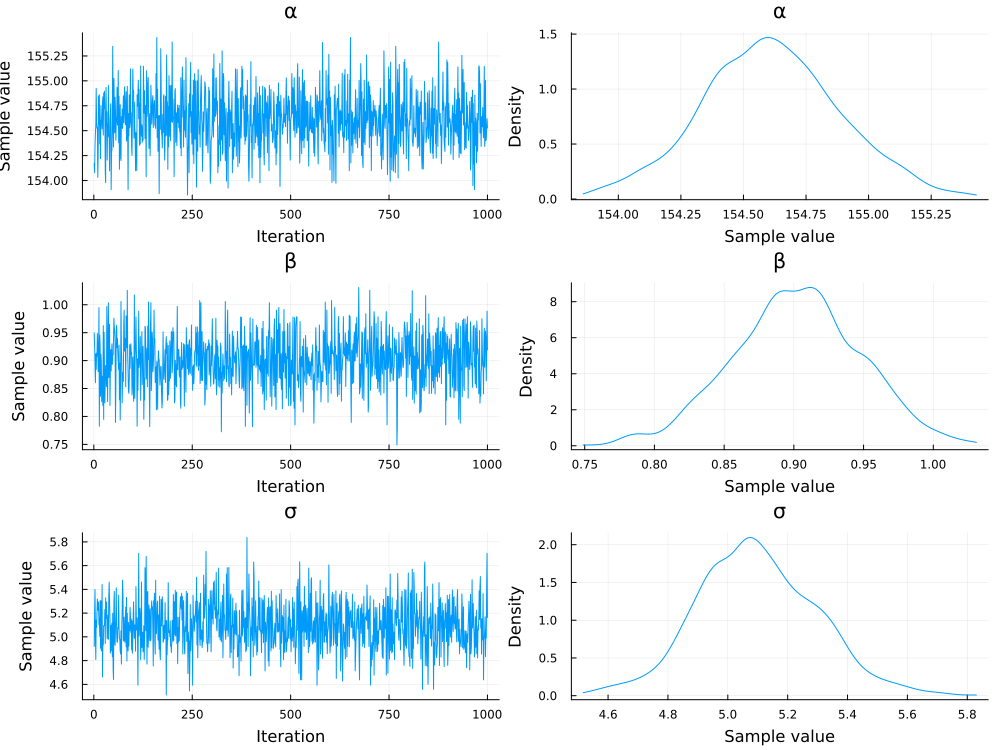

In [19]:
plot(samples)

In [20]:
# Use the mean values of α and β to plot the "best" fit line
α_mean = mean(samples[:α])


154.6103498092831

In [21]:
β_mean = mean(samples[:β])

0.9017978889769577

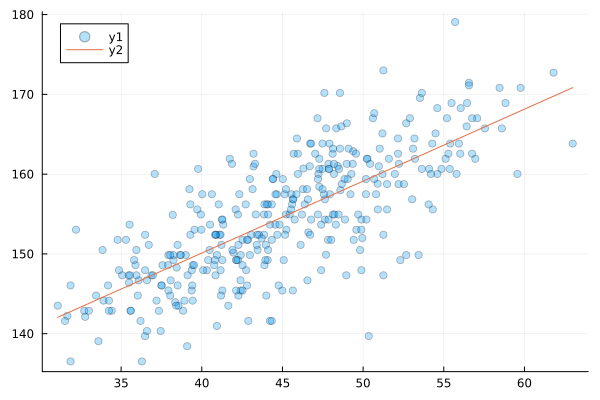

In [22]:
scatter(d2.weight, d2.height; alpha=0.3)
plot!(x -> α_mean + β_mean*(x-x̄))

In [23]:
# Let's reduce the sample size to 10 to explore posterior distributions of α and β
N = 10
dN = d2[1:N,:]

Row,height,weight,age,male
,Float64,Float64,Float64,Int64
1,151.765,47.8256,63.0,1
2,139.7,36.4858,63.0,0
3,136.525,31.8648,65.0,0
4,156.845,53.0419,41.0,1
5,145.415,41.2769,51.0,0
6,163.83,62.9926,35.0,1
7,149.225,38.2435,32.0,0
8,168.91,55.48,27.0,1
9,147.955,34.8699,19.0,0


In [24]:
x̄N = mean(dN.weight)

45.65686974999999

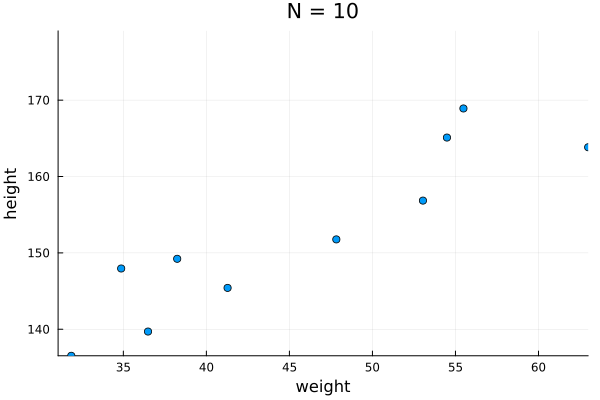

In [25]:
p = scatter(dN.weight, dN.height; xlims=xlims, ylims=ylims, label=false)
title!("N = $N"; xlab="weight", ylab="height")


In [26]:
mN = sample(height_regr_model(dN.weight, dN.height), NUTS(), 1000);

Sampling   0%|                                          |  ETA: N/A
┌ Info: Found initial step size
│   ϵ = 0.8
└ @ Turing.Inference /Users/lime/.julia/packages/Turing/vX5F9/src/mcmc/hmc.jl:213
Sampling   0%|▎                                         |  ETA: 0:00:00
Sampling   1%|▍                                         |  ETA: 0:00:00
Sampling   1%|▋                                         |  ETA: 0:00:00
Sampling   2%|▊                                         |  ETA: 0:00:00
Sampling   2%|█                                         |  ETA: 0:00:00
Sampling   3%|█▏                                        |  ETA: 0:00:00
Sampling   3%|█▍                                        |  ETA: 0:00:00
Sampling   4%|█▋                                        |  ETA: 0:00:00
Sampling   4%|█▊                                        |  ETA: 0:00:00
Sampling   5%|██                                        |  ETA: 0:00:00
Sampling   5%|██▏                                       |  ETA: 0:00:00
Sampling   6%|

In [27]:
# sample 20 values of α and β from the posterior
samplesN = sample(mN, 20);
samplesN_df = DataFrame(samplesN)

Row,iteration,chain,α,β,σ,lp,n_steps,is_accept,acceptance_rate,log_density,hamiltonian_energy,hamiltonian_energy_error,max_hamiltonian_energy_error,tree_depth,numerical_error,step_size,nom_step_size
,Int64,Int64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,1,1,152.478,0.984892,4.30785,-37.2331,7.0,1.0,0.975582,-37.2331,38.6148,-0.171282,-0.332911,2.0,0.0,0.799985,0.799985
2,2,1,153.666,0.910886,4.44231,-37.7877,3.0,1.0,0.879297,-37.7877,38.0898,0.137626,0.137626,2.0,0.0,0.799985,0.799985
3,3,1,150.935,1.01606,4.98793,-37.5018,3.0,1.0,0.909714,-37.5018,40.6558,-0.446465,-0.446465,2.0,0.0,0.799985,0.799985
4,4,1,152.995,0.979635,5.274,-37.4477,11.0,1.0,0.956898,-37.4477,37.6526,0.0440462,0.0828742,3.0,0.0,0.799985,0.799985
5,5,1,152.056,0.802236,3.96299,-37.9295,3.0,1.0,1.0,-37.9295,38.6564,-0.0599157,-0.321264,2.0,0.0,0.799985,0.799985
6,6,1,150.902,1.17968,6.43042,-38.8089,7.0,1.0,0.439083,-38.8089,41.8445,-0.602027,5.05068,3.0,0.0,0.799985,0.799985
7,7,1,153.623,0.997873,10.7735,-41.2768,3.0,1.0,0.322392,-41.2768,43.4338,0.90868,2.54163,2.0,0.0,0.799985,0.799985
8,8,1,152.321,0.8789,4.8325,-37.2183,7.0,1.0,0.965461,-37.2183,37.4442,0.018082,0.0668274,2.0,0.0,0.799985,0.799985
9,9,1,153.19,1.039,4.24931,-37.825,3.0,1.0,1.0,-37.825,40.1696,-0.923481,-0.923481,2.0,0.0,0.799985,0.799985


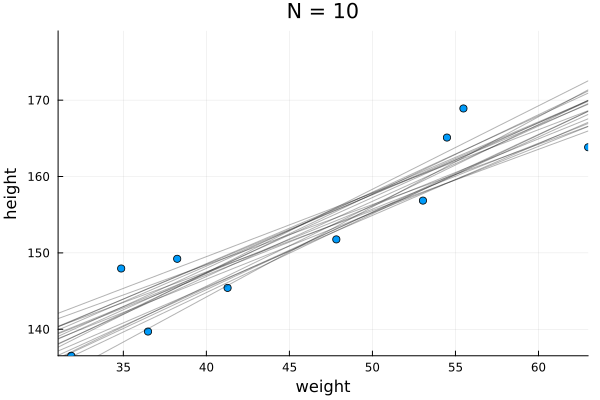

In [28]:
for (α_, β_) ∈ zip(samplesN_df.α, samplesN_df.β)
    plot!(x -> α_ + β_ * (x-x̄N); c="black", alpha=0.3, legend=false)
end
display(p)

Sampling   0%|                                          |  ETA: N/A
┌ Info: Found initial step size
│   ϵ = 0.2
└ @ Turing.Inference /Users/lime/.julia/packages/Turing/vX5F9/src/mcmc/hmc.jl:213
Sampling   0%|▎                                         |  ETA: 0:00:01
Sampling   1%|▍                                         |  ETA: 0:00:01
Sampling   1%|▋                                         |  ETA: 0:00:00
Sampling   2%|▊                                         |  ETA: 0:00:01
Sampling   2%|█                                         |  ETA: 0:00:01
Sampling   3%|█▏                                        |  ETA: 0:00:01
Sampling   3%|█▍                                        |  ETA: 0:00:01
Sampling   4%|█▋                                        |  ETA: 0:00:01
Sampling   4%|█▊                                        |  ETA: 0:00:00
Sampling   5%|██                                        |  ETA: 0:00:00
Sampling   5%|██▏                                       |  ETA: 0:00:00
Sampling   6%|

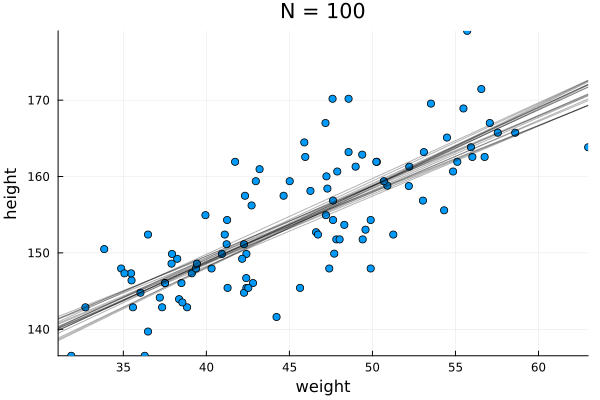

In [29]:
# Let's change the sample size to a different value to explore posterior distributions of α and β
N = 100
dN = d2[1:N,:];

x̄N = mean(dN.weight)

mN = sample(height_regr_model(dN.weight, dN.height), NUTS(), 1000);

# sample 20 values of α and β from the posterior
samplesN = sample(mN, 20);
samplesN_df = DataFrame(samplesN);

p = scatter(dN.weight, dN.height; xlims=xlims, ylims=ylims, label=false);
title!("N = $N"; xlab="weight", ylab="height");

x̄N = mean(dN.weight);
for (α_, β_) ∈ zip(samplesN_df.α, samplesN_df.β)
    plot!(x -> α_ + β_ * (x-x̄N); c="black", alpha=0.3, legend=false)
end
display(p)


In [30]:
# Let's now go back to our original posterior distribution obtained from all the adult data and take 1000 samples
samples = sample(m, 1000);
samples_df = DataFrame(samples)


Row,iteration,chain,α,β,σ,lp,n_steps,is_accept,acceptance_rate,log_density,hamiltonian_energy,hamiltonian_energy_error,max_hamiltonian_energy_error,tree_depth,numerical_error,step_size,nom_step_size
,Int64,Int64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,1,1,154.552,0.861843,4.69277,-1081.88,1.0,1.0,1.0,-1081.88,1084.54,-1.21506,-1.21506,1.0,0.0,1.0843,1.0843
2,2,1,154.547,0.885557,5.01859,-1079.11,3.0,1.0,1.0,-1079.11,1079.32,-0.0459716,-0.0624652,2.0,0.0,1.0843,1.0843
3,3,1,154.664,0.957768,5.32205,-1080.42,3.0,1.0,0.674525,-1080.42,1083.61,0.043458,1.10258,2.0,0.0,1.0843,1.0843
4,4,1,154.458,0.890276,5.16653,-1079.23,3.0,1.0,0.992584,-1079.23,1079.25,0.0224998,-0.0491251,2.0,0.0,1.0843,1.0843
5,5,1,154.542,0.864109,5.22245,-1079.68,3.0,1.0,0.966892,-1079.68,1080.96,-0.233662,-0.233662,2.0,0.0,1.0843,1.0843
6,6,1,154.946,0.916627,4.97508,-1079.97,3.0,1.0,0.634244,-1079.97,1085.02,-0.707847,0.979585,2.0,0.0,1.0843,1.0843
7,7,1,154.653,0.851602,5.41397,-1081.05,3.0,1.0,0.64126,-1081.05,1081.87,0.399432,0.531841,2.0,0.0,1.0843,1.0843
8,8,1,154.681,0.91166,5.15092,-1079.05,3.0,1.0,0.350524,-1079.05,1083.23,0.0,1.24517,1.0,0.0,1.0843,1.0843
9,9,1,154.029,0.895281,4.95603,-1081.52,3.0,1.0,0.916863,-1081.52,1081.93,0.286897,0.286897,2.0,0.0,1.0843,1.0843


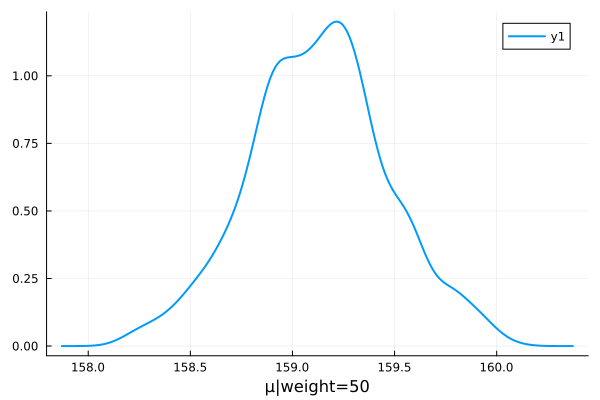

In [31]:
# posterior distribution of μ for one particular value of weight
μ_at_50 =  samples_df.α .+ samples_df.β * (50 - x̄);
density(μ_at_50; lw=2, xlab="μ|weight=50")

#### Optional (using $x_i$'s from the data)

In [32]:
# now do the same for all weight values in the data

μ = zeros(1000, 352);

for j in 1:1000
    for i in 1:352
        μ[j,i] = samples_df.α[j] + samples_df.β[j] * (d2.weight[i] - x̄)
    end
end

μ

1000×352 Matrix{Float64}:
 156.996  147.223  143.24   161.491  …  145.293  160.734  162.371  161.052
 157.057  147.015  142.923  161.677     145.032  160.898  162.58   161.225
 157.379  146.519  142.093  162.375     144.374  161.534  163.353  161.887
 156.982  146.887  142.773  161.626     144.893  160.844  162.535  161.172
 156.992  147.193  143.2    161.499     145.258  160.74   162.381  161.058
 157.545  147.151  142.915  162.326  …  145.098  161.521  163.262  161.859
 157.067  147.41   143.475  161.509     145.503  160.761  162.378  161.075
 157.265  146.927  142.714  162.021     144.885  161.22   162.951  161.556
 156.567  146.415  142.278  161.237     144.41   160.45   162.151  160.78
 157.688  148.142  144.252  162.08      146.256  161.34   162.939  161.65
   ⋮                                 ⋱                      ⋮      
 157.216  146.407  142.002  162.188     144.272  161.35   163.16   161.701
 157.176  146.079  141.557  162.281     143.888  161.421  163.28   161.782
 157.168

In [33]:
# a fancier way to do the same
μ = map(w -> samples_df.α + samples_df.β * (w - x̄), d2.weight);

# 352-element vector where each element is a vector of 1000 elements
# these 1000 elements are obtained from 1000 combinations of α and β sampled from the posterior

μ = hcat(μ...) # turn the above array into 1000 x 352 matrix

1000×352 Matrix{Float64}:
 156.996  147.223  143.24   161.491  …  145.293  160.734  162.371  161.052
 157.057  147.015  142.923  161.677     145.032  160.898  162.58   161.225
 157.379  146.519  142.093  162.375     144.374  161.534  163.353  161.887
 156.982  146.887  142.773  161.626     144.893  160.844  162.535  161.172
 156.992  147.193  143.2    161.499     145.258  160.74   162.381  161.058
 157.545  147.151  142.915  162.326  …  145.098  161.521  163.262  161.859
 157.067  147.41   143.475  161.509     145.503  160.761  162.378  161.075
 157.265  146.927  142.714  162.021     144.885  161.22   162.951  161.556
 156.567  146.415  142.278  161.237     144.41   160.45   162.151  160.78
 157.688  148.142  144.252  162.08      146.256  161.34   162.939  161.65
   ⋮                                 ⋱                      ⋮      
 157.216  146.407  142.002  162.188     144.272  161.35   163.16   161.701
 157.176  146.079  141.557  162.281     143.888  161.421  163.28   161.782
 157.168

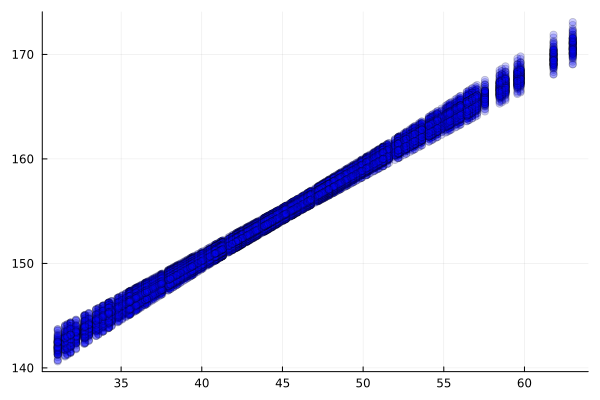

In [34]:
# plot the first 100 values of μ
p = plot()
for j in 1:100
    scatter!(d2.weight, μ[j,:]; c=:blue, alpha=0.2, label=false)
end
display(p)

#### Using a uniform sequence of $x$'s

In [35]:
# Now, consider μ for a defined weight sequence (not the weight values from the data)
x_seq = 25:70

25:70

In [36]:
μ_seq = zeros(1000, length(x_seq));

for j in 1:1000
    for i in 1:length(x_seq)
        μ_seq[j,i] = samples_df.α[j] + samples_df.β[j] * (x_seq[i] - x̄)
    end
end

μ_seq

1000×46 Matrix{Float64}:
 137.324  138.186  139.047  139.909  …  173.521  174.383  175.245  176.107
 136.844  137.729  138.615  139.501     174.037  174.923  175.808  176.694
 135.518  136.476  137.433  138.391     175.744  176.702  177.66   178.617
 136.661  137.552  138.442  139.332     174.053  174.943  175.833  176.724
 137.268  138.132  138.996  139.86      173.56   174.425  175.289  176.153
 136.622  137.539  138.456  139.372  …  175.121  176.037  176.954  177.871
 137.629  138.48   139.332  140.184     173.396  174.248  175.099  175.951
 136.456  137.368  138.279  139.191     174.746  175.657  176.569  177.481
 136.132  137.027  137.922  138.818     173.734  174.629  175.524  176.419
 138.472  139.314  140.156  140.998     173.83   174.672  175.514  176.356
   ⋮                                 ⋱                               ⋮
 135.459  136.412  137.365  138.318     175.492  176.445  177.398  178.352
 134.84   135.818  136.797  137.775     175.94   176.919  177.897  178.876
 135

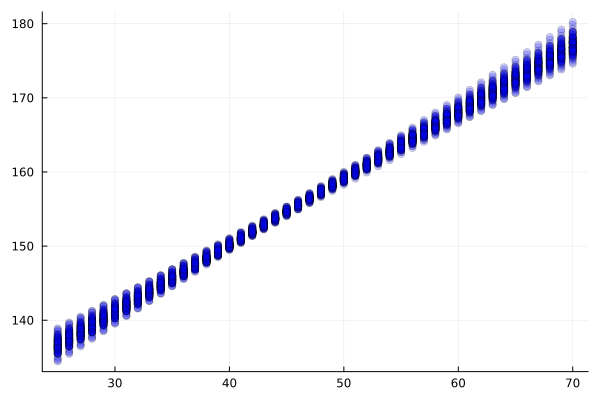

In [37]:
p = plot()
for j in 1:100
    scatter!(x_seq, μ_seq[j,:]; c=:blue, alpha=0.2, label=false)
end
display(p)

In [38]:
μ_seq_mean = zeros(length(x_seq));
μ_seq_CredI = zeros(length(x_seq),2);

for i in 1:length(x_seq)  # mean and credible interval for each column (each value of weight)
    μ_seq_mean[i] = mean(μ_seq[:,i])
    μ_seq_CredI[i,:] = CredI(μ_seq[:,i])
end

In [39]:
# a fancier way to do the same
μ_seq = map(x -> samples_df.α + samples_df.β * (x - x̄), x_seq)
μ_seq = hcat(μ_seq...)

μ_seq_mean = mean.(eachcol(μ_seq))
μ_seq_CredI = CredI.(eachcol(μ_seq))
μ_seq_CredI = vcat(μ_seq_CredI'...) # convert vector of vector into 46x2 matrix

46×2 Matrix{Float64}:
 134.858  138.526
 135.846  139.315
 136.831  140.153
 137.802  140.964
 138.773  141.775
 139.752  142.587
 140.715  143.399
 141.69   144.233
 142.668  145.073
 143.647  145.914
   ⋮      
 168.47   171.492
 169.31   172.465
 170.138  173.45
 170.967  174.434
 171.791  175.419
 172.603  176.398
 173.414  177.376
 174.226  178.355
 175.038  179.357

In [40]:
μ_seq_CredI

46×2 Matrix{Float64}:
 134.858  138.526
 135.846  139.315
 136.831  140.153
 137.802  140.964
 138.773  141.775
 139.752  142.587
 140.715  143.399
 141.69   144.233
 142.668  145.073
 143.647  145.914
   ⋮      
 168.47   171.492
 169.31   172.465
 170.138  173.45
 170.967  174.434
 171.791  175.419
 172.603  176.398
 173.414  177.376
 174.226  178.355
 175.038  179.357

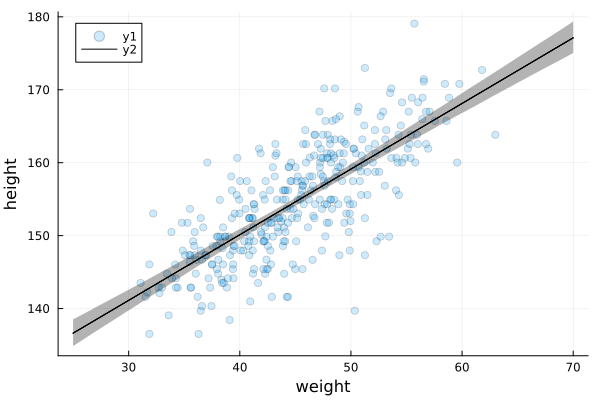

In [41]:
scatter(d2.weight, d2.height; alpha=0.2, xlab="weight", ylab="height")
plot!(x_seq, μ_seq_mean; c=:black)
plot!(x_seq, [μ_seq_mean μ_seq_mean]; c=:black, fillrange=μ_seq_CredI, fillalpha=0.3, label=false)

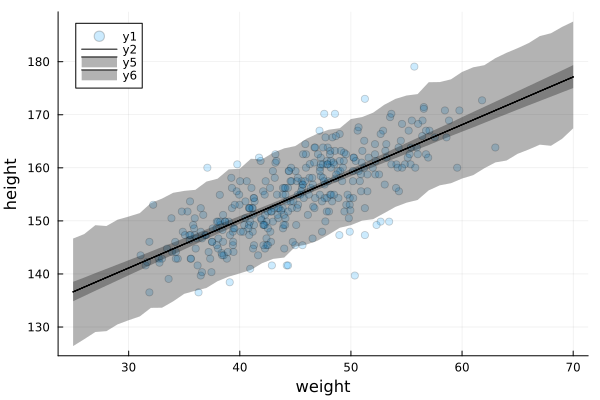

In [42]:
sim_height = zeros(1000, length(x_seq));

for j in 1:1000
    for i in 1:length(x_seq)
        sim_height[j,i] = rand(Normal(samples_df.α[j] + samples_df.β[j] * (x_seq[i] - x̄), samples_df.σ[j]))
    end
end

height_CredI = zeros(length(x_seq),2);

for i in 1:length(x_seq)  # mean and credible interval for each column (each value of weight)
    height_CredI[i,:] = CredI(sim_height[:,i])
end

plot!(x_seq, [μ_seq_mean μ_seq_mean]; c=:black, fillrange=height_CredI, fillalpha=0.3)

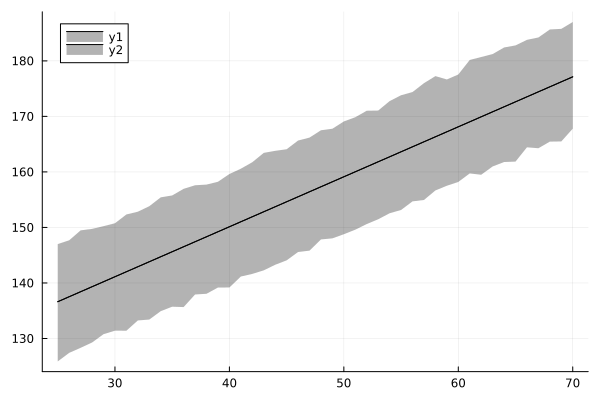

In [43]:
# a fancier way to do the same
sim_height = map(x -> rand.(Normal.(samples_df.α + samples_df.β * (x - x̄), samples_df.σ)), x_seq)
sim_height = hcat(sim_height...);

height_CredI = CredI.(eachcol(sim_height))
height_CredI = vcat(height_CredI'...);

plot(x_seq, [μ_seq_mean μ_seq_mean]; c=:black, fillrange=height_CredI, fillalpha=0.3)
